<a href="https://colab.research.google.com/github/Mida2304/LABORATORIO3/blob/main/laboratorio3.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
!pip install librosa matplotlib
!pip install pydub
!apt-get install ffmpeg
!pip install numpy
!pip install soundfile
!pip install librosa matplotlib pydub numpy soundfile
!apt-get install ffmpeg

Reading package lists... Done
Building dependency tree... Done
Reading state information... Done
ffmpeg is already the newest version (7:4.4.2-0ubuntu0.22.04.1).
0 upgraded, 0 newly installed, 0 to remove and 29 not upgraded.
Reading package lists... Done
Building dependency tree... Done
Reading state information... Done
ffmpeg is already the newest version (7:4.4.2-0ubuntu0.22.04.1).
0 upgraded, 0 newly installed, 0 to remove and 29 not upgraded.


<ipython-input-9-87bcea0daa0f>:11: UserWarning: PySoundFile failed. Trying audioread instead.
  y, sr = librosa.load(audio_file, sr=None)
/usr/local/lib/python3.11/dist-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


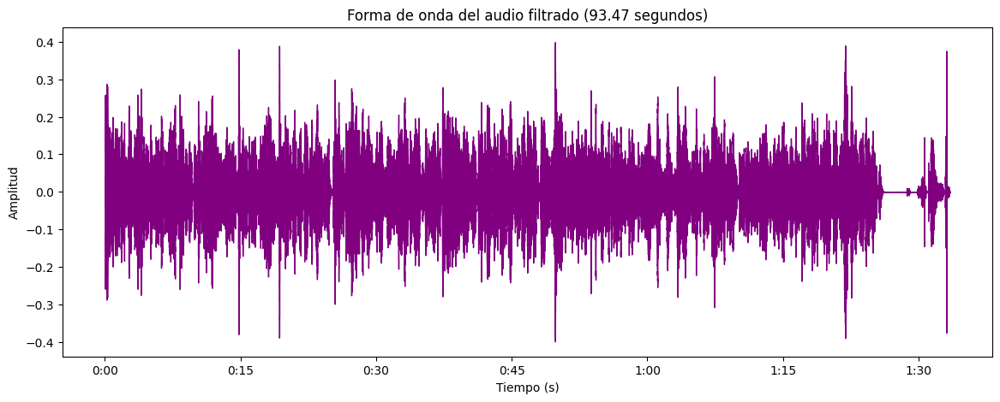

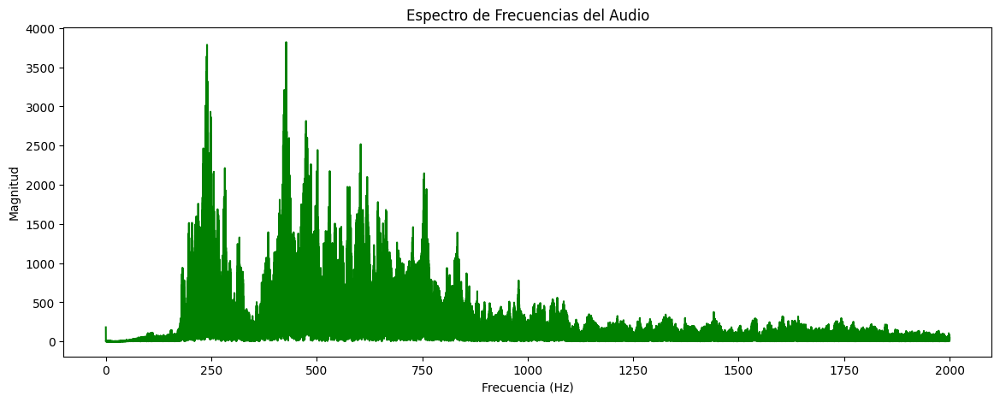

In [9]:
import librosa
import librosa.display
import matplotlib.pyplot as plt
import numpy as np
from scipy.signal import butter, filtfilt

# Reemplaza 'nombre_del_archivo.ext' con el nombre de tu archivo
audio_file = 'AUDIO 1.mp3'

# Cargar el archivo de audio
y, sr = librosa.load(audio_file, sr=None)

# Definir el filtro de paso bajo
def butter_lowpass(cutoff, sr, order=5):
    nyquist = 0.5 * sr  # Frecuencia de Nyquist
    normal_cutoff = cutoff / nyquist
    b, a = butter(order, normal_cutoff, btype='low', analog=False)
    return b, a

def lowpass_filter(data, cutoff, sr, order=5):
    b, a = butter_lowpass(cutoff, sr, order=order)
    y_filtered = filtfilt(b, a, data)
    return y_filtered

# Parámetros del filtro
cutoff_frequency = 2000  # Frecuencia de corte del filtro (en Hz)
filtered_y = lowpass_filter(y, cutoff_frequency, sr)

# Obtener la duración del audio filtrado
duration = librosa.get_duration(y=filtered_y, sr=sr)

# Calcular la FFT del audio filtrado
fft_spectrum = np.fft.fft(filtered_y)
frequencies = np.fft.fftfreq(len(fft_spectrum), 1 / sr)

# Calcular la magnitud de la FFT
magnitude = np.abs(fft_spectrum)

# Filtrar frecuencias de interés (0 a 2000 Hz)
positive_frequencies = frequencies[(frequencies >= 0) & (frequencies <= 2000)]
positive_magnitude = magnitude[(frequencies >= 0) & (frequencies <= 2000)]

# Crear el gráfico de la señal filtrada
plt.figure(figsize=(14, 5))
librosa.display.waveshow(filtered_y, sr=sr, color='purple')
plt.title(f'Forma de onda del audio filtrado ({duration:.2f} segundos)')
plt.xlabel('Tiempo (s)')
plt.ylabel('Amplitud')
plt.show()

# Crear el gráfico del espectro de frecuencias
plt.figure(figsize=(14, 5))
plt.plot(positive_frequencies, positive_magnitude, color='green')
plt.title('Espectro de Frecuencias del Audio')
plt.xlabel('Frecuencia (Hz)')
plt.ylabel('Magnitud')
plt.show()


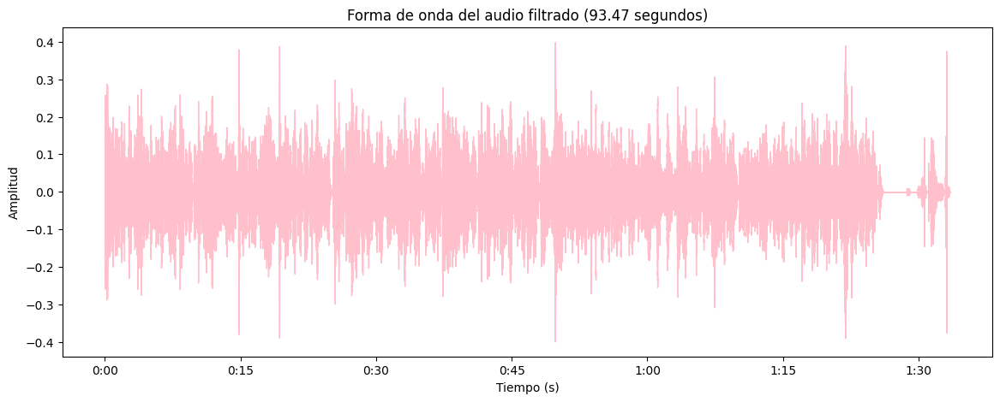

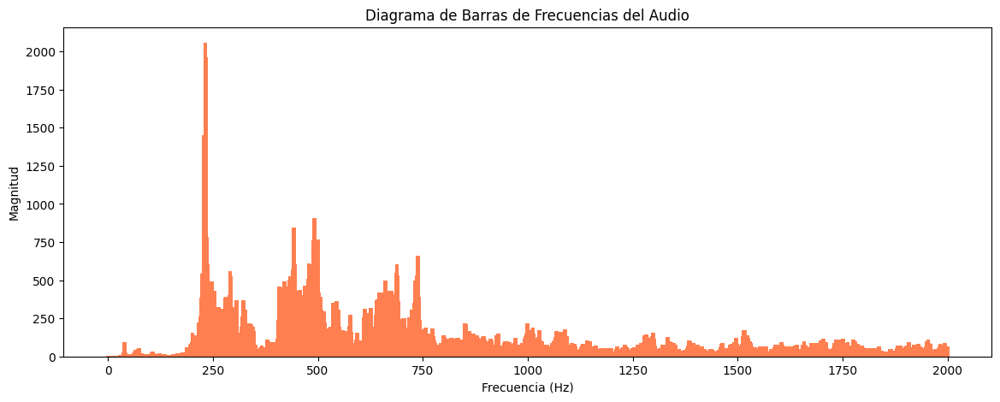

In [12]:
import librosa
import matplotlib.pyplot as plt
import numpy as np

# Reemplaza 'nombre_del_archivo.ext' con el nombre de tu archivo
audio_file = 'Audio Manuela.mp3'

# Cargar solo los primeros 5 segundos del archivo de audio
y, sr = librosa.load(audio_file, sr=None, duration=8)

# Calcular la FFT usando una parte más pequeña del audio
fft_spectrum = np.fft.fft(y)
frequencies = np.fft.fftfreq(len(fft_spectrum), 1 / sr)

# Calcular la magnitud de la FFT
magnitude = np.abs(fft_spectrum)

# Filtrar frecuencias de interés (0 a 2000 Hz)
positive_frequencies = frequencies[(frequencies >= 0) & (frequencies <= 2000)]
positive_magnitude = magnitude[(frequencies >= 0) & (frequencies <= 2000)]

# Crear el gráfico de la señal filtrada
plt.figure(figsize=(14, 5))
librosa.display.waveshow(filtered_y, sr=sr, color='pink')
plt.title(f'Forma de onda del audio filtrado ({duration:.2f} segundos)')
plt.xlabel('Tiempo (s)')
plt.ylabel('Amplitud')
plt.show()

# Crear el histograma de frecuencias
plt.figure(figsize=(14, 5))
plt.bar(positive_frequencies, positive_magnitude, width=10, color='#FF7F50')
plt.title('Diagrama de Barras de Frecuencias del Audio')
plt.xlabel('Frecuencia (Hz)')
plt.ylabel('Magnitud')
plt.show()

In [5]:
import librosa
import numpy as np
from scipy.signal import butter, filtfilt
from IPython.display import Audio, display

# Reemplaza con los nombres de tus archivos de audio
audio_file = 'AUDIO 1.mp3'
audio_file2 = 'Audio Manuela.mp3'
ruido = 'silenci.mp3'

# Cargar los archivos de audio
y, sr = librosa.load(audio_file, sr=None)
y2, sr2 = librosa.load(audio_file2, sr=None)
r, sr4 = librosa.load(ruido, sr=None)

# Asegurarse de que el ruido tenga el mismo tamaño que las señales de audio
if len(r) > len(y):
    r = r[:len(y)]
else:
    y = y[:len(r)]

if len(r) > len(y2):
    r = r[:len(y2)]
else:
    y2 = y2[:len(r)]



# Definir función para calcular el SNR
def calculate_snr(signal, noise):
    signal_power = np.mean(signal ** 2)  # Potencia de la señal
    noise_power = np.mean(noise ** 2)    # Potencia del ruido
    snr = 10 * np.log10(signal_power / noise_power)  # SNR en dB
    return snr

# Calcular el SNR para cada par de archivos de audio y ruido
snr1 = calculate_snr(y, r)
snr2 = calculate_snr(y2, r)


# Definir el filtro de paso de banda
def butter_bandpass(lowcut, highcut, sr, order=5):
    nyquist = 0.5 * sr  # Frecuencia de Nyquist
    low = lowcut / nyquist
    high = highcut / nyquist
    b, a = butter(order, [low, high], btype='band')
    return b, a

def bandpass_filter(data, lowcut, highcut, sr, order=5):
    b, a = butter_bandpass(lowcut, highcut, sr, order=order)
    y_filtered = filtfilt(b, a, data)
    return y_filtered

# Parámetros del filtro
lowcut_frequency = 165     # Frecuencia de corte inferior (en Hz)
highcut_frequency = 1100  # Frecuencia de corte superior (en Hz)

# Aplicar el filtro de paso de banda a cada archivo
filtered_y = bandpass_filter(y, lowcut_frequency, highcut_frequency, sr)
filtered_y2 = bandpass_filter(y2, lowcut_frequency, highcut_frequency, sr2)

# Normalizar el audio filtrado para evitar clipping
filtered_y = filtered_y / np.max(np.abs(filtered_y))
filtered_y2 = filtered_y2 / np.max(np.abs(filtered_y2))


# Imprimir los resultados de SNR
print(f"SNR del primer archivo: {snr1:.2f} dB")
print(f"SNR del segundo archivo: {snr2:.2f} dB")


# Mostrar y reproducir los audios filtrados
display(Audio(filtered_y, rate=sr))   # Reproducir primer archivo
display(Audio(filtered_y2, rate=sr2))  # Reproducir segundo archivo


<ipython-input-5-2f06848c98ff>:12: UserWarning: PySoundFile failed. Trying audioread instead.
  y, sr = librosa.load(audio_file, sr=None)
/usr/local/lib/python3.11/dist-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


SNR del primer archivo: 58.82 dB
SNR del segundo archivo: 58.87 dB


In [6]:
import librosa
import numpy as np
from scipy.fft import fft, ifft
from IPython.display import Audio, display

# Reemplaza con los nombres de tus archivos de audio
audio_file = 'AUDIO 1.mp3'
audio_file2 = 'Audio Manuela.mp3'


# Cargar los archivos de audio
y, sr = librosa.load(audio_file, sr=None)
y2, sr2 = librosa.load(audio_file2, sr=None)


# Definir el filtro de paso de banda usando la Transformada de Fourier
def fourier_bandpass_filter(data, sr, lowcut, highcut):
    # Transformar la señal al dominio de la frecuencia
    fft_data = fft(data)
    frequencies = np.fft.fftfreq(len(data), 1/sr)

    # Crear una máscara para el filtro de paso de banda
    mask = np.logical_and(frequencies > lowcut, frequencies < highcut)

    # Aplicar la máscara a los datos de frecuencia (dominio positivo y negativo)
    fft_data_filtered = np.zeros_like(fft_data)
    fft_data_filtered[mask] = fft_data[mask]
    fft_data_filtered[~mask] = fft_data[~mask]  # Simetría usando el operador `~`

    # Transformar de vuelta al dominio del tiempo
    filtered_data = np.real(ifft(fft_data_filtered))

    return filtered_data

# Parámetros del filtro
lowcut_frequency = 150     # Frecuencia de corte inferior (en Hz)
highcut_frequency = 4000   # Frecuencia de corte superior (en Hz)

# Aplicar el filtro de paso de banda a cada archivo
filtered_y = fourier_bandpass_filter(y, sr, lowcut_frequency, highcut_frequency)
filtered_y2 = fourier_bandpass_filter(y2, sr2, lowcut_frequency, highcut_frequency)

# Normalizar el audio filtrado para evitar clipping
filtered_y = filtered_y / np.max(np.abs(filtered_y))
filtered_y2 = filtered_y2 / np.max(np.abs(filtered_y2))


# Mostrar y reproducir los audios filtrados
display(Audio(filtered_y, rate=sr))   # Reproducir primer archivo
display(Audio(filtered_y2, rate=sr2))  # Reproducir segundo archivo


<ipython-input-6-57cc6abdc0f5>:12: UserWarning: PySoundFile failed. Trying audioread instead.
  y, sr = librosa.load(audio_file, sr=None)
/usr/local/lib/python3.11/dist-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)
